In [1]:
import os
from dotenv import load_dotenv
import os
import requests
import time
from PIL import Image
from io import BytesIO

load_dotenv(override=True)

# Đọc API Key từ biến môi trường
FREEPIK_API_KEY = os.getenv("FREEPIK_API_KEY")
if not FREEPIK_API_KEY:
    print("❌ Lỗi: Chưa cài đặt biến môi trường FREEPIK_API_KEY!")
else:
    print("✅ API Key đã sẵn sàng!")

# Hàm chuẩn hóa tên file (loại bỏ ký tự đặc biệt)
def sanitize_filename(filename):
    return "".join(c if c.isalnum() or c in " _-" else "_" for c in filename)


✅ API Key đã sẵn sàng!


In [4]:
# Bước 1: Gửi yêu cầu tạo ảnh
# Bước 1: Gửi yêu cầu tạo ảnh với các tham số nâng cao
def create_image(
    prompt="a cat with wings, playing the guitar, and wearing a hat",
    resolution="2k",  # 2k hoặc 4k
    aspect_ratio="square_1_1",  # Các tỷ lệ hình ảnh
    realism=True,  # True = Tăng độ chân thực, False = Giữ nguyên AI style
    creative_detailing=33,  # Mức độ chi tiết (0-100)
    engine="automatic"  # Chọn mô hình AI
):
    create_url = "https://api.freepik.com/v1/ai/mystic"
    
    # Xây dựng payload với các tham số đã cập nhật
    payload = {
        "prompt": prompt,
        "resolution": resolution,
        "aspect_ratio": aspect_ratio,
        "realism": realism,
        "creative_detailing": creative_detailing,
        "engine": engine
    }
    
    headers = {
        "x-freepik-api-key": FREEPIK_API_KEY,
        "Content-Type": "application/json"
    }

    # Gửi yêu cầu POST đến API Freepik AI
    response = requests.post(create_url, json=payload, headers=headers)

    if response.status_code == 200:
        data = response.json()
        task_id = data.get("data", {}).get("task_id")
        if task_id:
            print(f"✅ Ảnh đang được tạo! Task ID: {task_id}")
            return task_id
        else:
            print("❌ Không nhận được task_id! Kiểm tra lại API.")
    else:
        print(f"❌ Lỗi khi gửi yêu cầu tạo ảnh: {response.text}")
    return None


# Bước 2: Kiểm tra trạng thái ảnh
def check_status(task_id, max_retries=20, retry_delay=25):
    status_url = f"https://api.freepik.com/v1/ai/mystic/{task_id}"  
    headers = {"x-freepik-api-key": FREEPIK_API_KEY}
    
    start_time = time.time()
    
    for attempt in range(max_retries):
        elapsed_time = int(time.time() - start_time)
        response = requests.get(status_url, headers=headers)

        if response.status_code == 200:
            data = response.json()
            status = data.get("data", {}).get("status")

            if status == "COMPLETED":
                image_urls = data.get("data", {}).get("generated", [])
                if image_urls:
                    print(f"✅ Ảnh đã sẵn sàng sau {elapsed_time} giây! 🚀")
                    return image_urls[0]
                else:
                    print("❌ Ảnh không tồn tại dù trạng thái là COMPLETED.")
                    return None
            elif status == "FAILED":
                print("❌ Quá trình tạo ảnh thất bại.")
                return None
            else:
                print(f"⏳ Đang chờ ảnh... ({elapsed_time}s trôi qua, lần thử {attempt+1}/{max_retries})")
                time.sleep(retry_delay)
        elif response.status_code == 404:
            print(f"⚠️ Task ID chưa tồn tại ({elapsed_time}s). Có thể API cần thêm thời gian...")
            time.sleep(retry_delay)
        else:
            print(f"❌ Lỗi khi kiểm tra trạng thái ({response.status_code}): {response.text}")
            return None

    print("⏳ Hết số lần thử, ảnh có thể chưa được tạo hoàn tất.")
    return None

# Bước 3: Tải ảnh về máy
def download_image(image_url, prompt):
    filename = sanitize_filename(prompt)[:50] + ".jpg"  # Giới hạn tên file 50 ký tự
    response = requests.get(image_url)

    if response.status_code == 200:
        with open(filename, "wb") as file:
            file.write(response.content)
        print(f"📥 Ảnh đã được tải về: {filename}")

        # Hiển thị ảnh ngay trong Jupyter Notebook
        img = Image.open(BytesIO(response.content))
        display(img)
    else:
        print(f"❌ Lỗi khi tải ảnh: {response.status_code}")


# 🎨 Freepik AI Image Generation - API Parameters

## **📌 1. Resolution (`resolution`)**
- **Loại**: `enum<string>`
- **Mặc định**: `2k`
- **Mô tả**: Độ phân giải của ảnh.
- **Tuỳ chọn khả dụng**:
  - `2k`
  - `4k`

---

## **📌 2. Aspect Ratio (`aspect_ratio`)**
- **Loại**: `enum<string>`
- **Mặc định**: `square_1_1`
- **Mô tả**: Tỷ lệ khung hình của ảnh. Đây là tỷ lệ giữa chiều rộng và chiều cao, được biểu thị dưới dạng `_width_height`.
- **Nếu không có, mặc định là** `square_1_1`
- **Tuỳ chọn khả dụng**:
  - `square_1_1` (1:1 - Vuông)
  - `classic_4_3` (4:3 - Tỷ lệ cổ điển)
  - `traditional_3_4` (3:4 - Dọc truyền thống)
  - `widescreen_16_9` (16:9 - Màn hình rộng)
  - `social_story_9_16` (9:16 - Câu chuyện mạng xã hội)
  - `smartphone_horizontal_20_9` (20:9 - Ngang điện thoại)
  - `smartphone_vertical_9_20` (9:20 - Dọc điện thoại)
  - `standard_3_2` (3:2 - Chuẩn)
  - `portrait_2_3` (2:3 - Chân dung)
  - `horizontal_2_1` (2:1 - Ngang)
  - `vertical_1_2` (1:2 - Dọc)
  - `social_5_4` (5:4 - Xã hội)
  - `social_post_4_5` (4:5 - Bài đăng mạng xã hội)

---

## **📌 3. Realism (`realism`)**
- **Loại**: `boolean`
- **Mặc định**: `true`
- **Mô tả**:
  - Tính năng thử nghiệm giúp ảnh trông **thực tế hơn** (bớt cảm giác do AI tạo ra).
  - Hiệu quả nhất với ảnh chụp hoặc tranh minh họa.
  - **Lưu ý**: Nếu bạn tạo ảnh mang tính **kỳ ảo** hoặc **nhân vật hư cấu**, hãy **tắt** `realism` để AI tuân theo prompt tốt hơn.

---

## **📌 4. Creative Detailing (`creative_detailing`)**
- **Loại**: `integer`
- **Mặc định**: `33`
- **Mô tả**:
  - Giá trị cao hơn giúp tăng chi tiết trên mỗi pixel, nhưng có thể làm ảnh trông "HDR" hoặc giả tạo.
  - Giá trị **quá cao** có thể gây lỗi, ví dụ như xuất hiện mắt ở vị trí không mong muốn.
- **Giới hạn giá trị**: `0 < x < 100`

---

## **📌 5. Engine (`engine`)**
- **Loại**: `enum<string>`
- **Mặc định**: `automatic`
- **Mô tả**: Chọn mô hình AI để tạo ảnh.
- **Tuỳ chọn khả dụng**:
  - `automatic` (Mặc định)
  - `magnific_illusio` - Phù hợp với minh họa mượt mà, phong cảnh và thiên nhiên. Tạo hiệu ứng mềm mại.
  - `magnific_sharpy` - Tốt nhất cho ảnh chân thực (realistic). Tạo hình ảnh sắc nét và chi tiết nhất.
  - `magnific_sparkle` - Cân bằng giữa `Illusio` và `Sharpy`. Phù hợp với ảnh chân thực nhưng không quá sắc nét.

---

## **📌 🔹 Ghi chú quan trọng**
✅ **Sử dụng `realism=False` nếu tạo ảnh fantasy hoặc nhân vật giả tưởng**  
✅ **Tăng `creative_detailing` lên 50-70 nếu muốn chi tiết hơn, nhưng không nên quá cao**  
✅ **Chọn `engine=magnific_sharpy` nếu muốn ảnh siêu chi tiết và sắc nét**  
✅ **Chọn `engine=magnific_illusio` nếu muốn ảnh có nét mềm mại, phù hợp với tranh minh họa**  
✅ **Chọn `aspect_ratio=widescreen_16_9` nếu muốn ảnh làm hình nền**  


✅ Ảnh đang được tạo! Task ID: 69cd3963-87e0-4d45-8aeb-8c74e5eef3c9
⏳ Đang chờ ảnh... (0s trôi qua, lần thử 1/20)
⏳ Đang chờ ảnh... (25s trôi qua, lần thử 2/20)
⏳ Đang chờ ảnh... (50s trôi qua, lần thử 3/20)
⏳ Đang chờ ảnh... (76s trôi qua, lần thử 4/20)
✅ Ảnh đã sẵn sàng sau 101 giây! 🚀
📥 Ảnh đã được tải về: a futuristic city with flying cars and neon lights.jpg


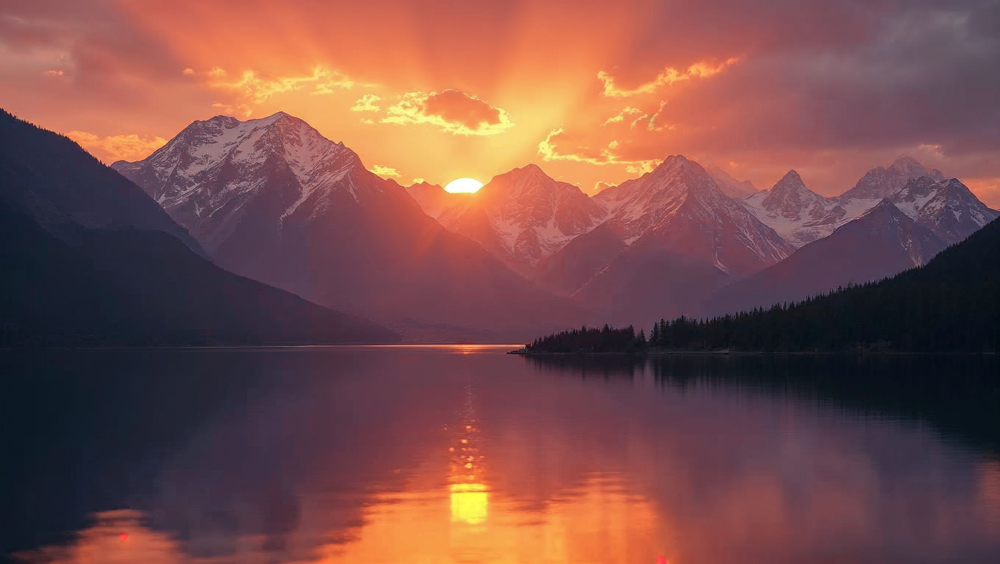

In [ ]:
# Nhập prompt mới
prompt = "A beautiful sunset over a mountain with a lake reflection"

# Tạo ảnh
task_id = create_image(
    prompt=prompt,
    resolution="4k",
    aspect_ratio="widescreen_16_9",
    realism=True,  # Làm cho ảnh chân thực hơn
    creative_detailing=50,  # Tăng mức độ chi tiết
    engine="magnific_sharpy"  # Mô hình sắc nét nhất
)

if task_id:
    image_url = check_status(task_id)
    if image_url:
        download_image(image_url, prompt)
